In [190]:
from sklearn import preprocessing
import pandas as pd
import numpy as np
from sklearn import tree
import matplotlib.pyplot as plt
from datetime import datetime
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats
import random
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import tensorflow as tf
import numpy as np

tf.random.set_seed(42)
np.random.seed(42)
random.seed(42)

In [120]:
df_per= pd.read_excel("C:/Users/57314/Documents/LEONARDO/CAR/CAR 2023/CIENCIA DE DATOS DLIA/DATOS RAMCA/Periodo 1 B. peristaltica.xlsx")
df_dia= pd.read_excel("C:/Users/57314/Documents/LEONARDO/CAR/CAR 2023/CIENCIA DE DATOS DLIA/DATOS RAMCA/Periodo 2. B diafragma.xlsx")


## Bomba peristaltica

In [121]:
len(df_per)

6828

In [122]:
df_per

,DateTime,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
0,2023-04-01 00:00:00,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,0.0,16.79,0.0
1,2023-04-01 00:05:00,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,0.0,16.79,0.0
2,2023-04-01 00:10:00,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,0.0,16.79,0.0
3,2023-04-01 00:15:00,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,0.0,16.83,0.0
4,2023-04-01 00:20:00,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,0.0,16.86,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6823,2023-04-27 23:35:00,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,0.0,16.75,0.0
6824,2023-04-27 23:40:00,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,0.0,16.74,0.0
6825,2023-04-27 23:45:00,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,0.0,16.75,0.0
6826,2023-04-27 23:50:00,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,0.0,16.74,0.0


In [123]:
df_per.describe()

,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
count,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6179.000000,6623.000000,6270.000000
mean,7.238013,409.282547,0.307146,54.201173,180.597217,19.470846,35.414780,154.433763,203.098597,205.918129,0.007589,18.969644,0.008134
std,0.198663,77.907842,1.043050,70.671662,43.138461,5.967620,6.291105,130.766617,385.121090,29.734286,0.051289,2.222191,0.134011
min,0.000000,0.000000,0.000000,0.000000,90.800000,2.290000,3.160000,26.270000,0.000000,159.090000,0.000000,0.000000,0.000000
25%,7.160000,356.485000,0.020000,18.545000,154.715000,14.390000,31.510000,55.720000,76.935000,181.645000,0.000000,17.390000,0.000000
50%,7.240000,419.150000,0.030000,38.400000,170.980000,17.990000,35.380000,109.560000,153.410000,200.150000,0.000000,18.570000,0.000000
75%,7.350000,448.895000,0.030000,60.975000,187.300000,24.765000,39.760000,216.645000,205.740000,217.490000,0.000000,20.520000,0.000000
max,7.910000,1331.600000,7.130000,2842.860000,534.690000,65.710000,51.080000,674.490000,13831.000000,486.800000,0.550000,25.080000,6.000000


In [124]:
df_per.dtypes

DateTime                datetime64[ns]
pH [pH]                        float64
X [uS/cm]                      float64
O2 [mg/l]                      float64
TUR [NTU]                      float64
NO3 [mg/l]                     float64
NH4 [mg/l]                     float64
K [mg/l]                       float64
Cloruros [mg/L]                float64
Solidos [mg/L]                 float64
Nivel [cm]                     float64
Velocidad [m/s]                float64
Temp [°C]                      float64
Pluviometro [mm/min]           float64
dtype: object

In [125]:
# Contar Nulos
null_count = df_per.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

DateTime                  0
pH [pH]                 205
X [uS/cm]               205
O2 [mg/l]               205
TUR [NTU]               205
NO3 [mg/l]              205
NH4 [mg/l]              205
K [mg/l]                205
Cloruros [mg/L]         205
Solidos [mg/L]          205
Nivel [cm]              205
Velocidad [m/s]         649
Temp [°C]               205
Pluviometro [mm/min]    558
dtype: int64


<AxesSubplot:>

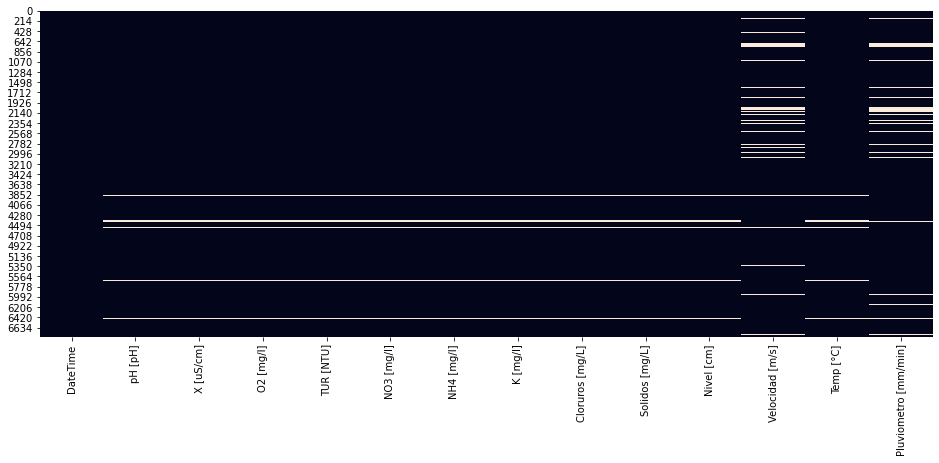

In [126]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_per.isnull(), cbar=False)

In [127]:
df_per["Pluviometro [mm/min]"].value_counts(dropna=False).head(10)

0.0    6235
NaN     558
1.0      27
2.0       4
3.0       2
6.0       1
4.0       1
Name: Pluviometro [mm/min], dtype: int64

In [128]:
df_per["Velocidad [m/s]"].value_counts(dropna=False).head(10)

0.00    6033
NaN      649
0.32       7
0.22       7
0.30       7
0.36       7
0.35       6
0.19       6
0.38       6
0.31       6
Name: Velocidad [m/s], dtype: int64

In [129]:
columnas_eliminar = ["Velocidad [m/s]", "Pluviometro [mm/min]"]
df_per = df_per.drop(columnas_eliminar, axis=1)

In [130]:
# Eliminamos las filas con missing Values, se elimina todos los las filas NAN son las mismas en todas las columnas 
df_per.dropna(subset=['pH [pH]'], inplace=True)

<AxesSubplot:>

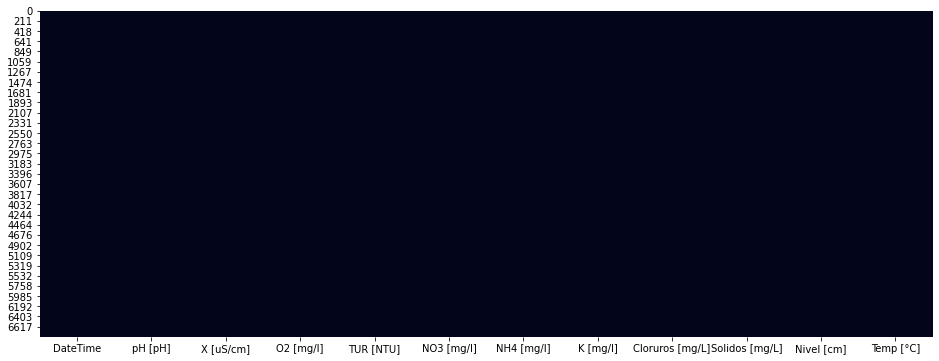

In [131]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_per.isnull(), cbar=False)

In [132]:
df_per.reset_index(drop=True, inplace=True)

<ipython-input-133-f048e6dcffe6>:3: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



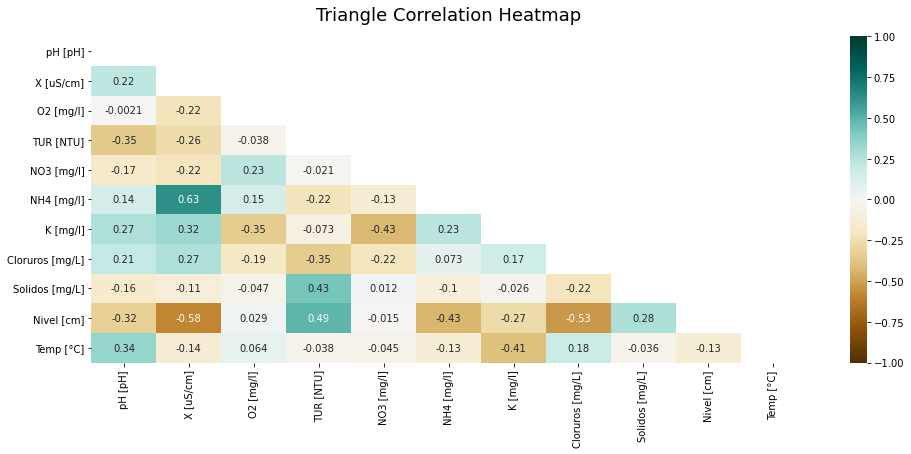

In [133]:
plt.figure(figsize=(16, 6))
# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(df_per.corr(), dtype=np.bool))
heatmap = sns.heatmap(df_per.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

In [134]:
df_per

,DateTime,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Temp [°C]
0,2023-04-01 00:00:00,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,16.79
1,2023-04-01 00:05:00,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,16.79
2,2023-04-01 00:10:00,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,16.79
3,2023-04-01 00:15:00,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,16.83
4,2023-04-01 00:20:00,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,16.86
...,...,...,...,...,...,...,...,...,...,...,...,...
6618,2023-04-27 23:35:00,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,16.75
6619,2023-04-27 23:40:00,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,16.74
6620,2023-04-27 23:45:00,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,16.75
6621,2023-04-27 23:50:00,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,16.74


In [135]:
columns = list(df_per.columns)
columns = columns[1:]

In [136]:
columns_sin_espacios = list()
for i in range(0,len(columns)):
    columnSinEspacios = columns[i].replace(" ", "")
    columnSinEspacios = columnSinEspacios.replace("[", "_")
    columnSinEspacios = columnSinEspacios.replace("]", "")
    columns_sin_espacios.append(columnSinEspacios)

In [137]:
for i in range(0,len(columns)):
    df_per = df_per.rename(columns={columns[i]: columns_sin_espacios[i]})

# Cambiar los nombres para el manejo de variables 

In [138]:
columns = list(df_per.columns)
columns = columns[1:]
columns

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [139]:
for column in columns:
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_per[column], name = "Violin"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Histogram(x=df_per[column], nbinsx=100, name = "Histograma"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Graficas de violin de "+ column +" para bomba peristaltica")

    # Mostrar la figura
    fig.show()


In [140]:
variables_z = list()
for column in columns:
    variable_name = "z_" + column
    globals()[variable_name] = np.abs(stats.zscore(df_per[column]))
    variables_z.append(variable_name)

In [141]:
variables_z

['z_pH_pH',
 'z_X_uS/cm',
 'z_O2_mg/l',
 'z_TUR_NTU',
 'z_NO3_mg/l',
 'z_NH4_mg/l',
 'z_K_mg/l',
 'z_Cloruros_mg/L',
 'z_Solidos_mg/L',
 'z_Nivel_cm',
 'z_Temp_°C']

In [142]:
z_pH_pH

0       0.292039
1       0.292039
2       0.292039
3       0.292039
4       0.292039
          ...   
6618    0.543741
6619    0.543741
6620    0.543741
6621    0.493400
6622    0.493400
Name: pH_pH, Length: 6623, dtype: float64

In [143]:
variables_atipicos = list()
for i in range(0,len(columns)):
    variable_name = "atp_" + columns[i]
    globals()[variable_name] = (np.where(globals()[variables_z[i]] > 3))
    variables_atipicos.append(variable_name)
variables_atipicos

['atp_pH_pH',
 'atp_X_uS/cm',
 'atp_O2_mg/l',
 'atp_TUR_NTU',
 'atp_NO3_mg/l',
 'atp_NH4_mg/l',
 'atp_K_mg/l',
 'atp_Cloruros_mg/L',
 'atp_Solidos_mg/L',
 'atp_Nivel_cm',
 'atp_Temp_°C']

In [144]:
atp_pH_pH

(array([ 656,  657,  668,  669,  670,  671,  672,  673,  674,  675,  676,
         677,  678,  679,  680,  717,  718,  719,  720,  721,  722,  723,
         724,  725, 2702, 2703, 3837, 3838, 3839, 3840, 3841, 3842, 3843,
        3844, 3845, 4619, 4620], dtype=int64),)

# Serie de tiempo con atipicos

In [145]:
valores_atipicos = df_per.loc[atp_pH_pH[0]]

In [146]:
fig = px.scatter(df_per, x='DateTime', y='pH_pH', title='Datos atipicos PH')
fig.update_xaxes(title_text='Fecha de Muestreo')
fig.update_yaxes(title_text='Valor numerico')

# Extraer los valores atípicos del DataFrame original
valores_atipicos = df_per.loc[atp_pH_pH[0]]

# Agregar marcadores para valores atípicos
fig.add_trace(go.Scatter(x=valores_atipicos['DateTime'], y=valores_atipicos['pH_pH'],
                         mode='markers', name='Valores Atípicos', marker=dict(size=8, color='red')))

fig.show()


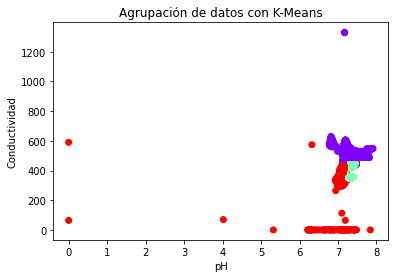

In [147]:
from sklearn.cluster import KMeans

# Selecciona las columnas relevantes para la agrupación
selected_columns = ['pH_pH', 'X_uS/cm', 'O2_mg/l', 'TUR_NTU', 'NO3_mg/l', 'NH4_mg/l', 'K_mg/l', 'Cloruros_mg/L', 'Solidos_mg/L', 'Nivel_cm', 'Temp_°C']
X = df_per[selected_columns]

X_normalized = (X - X.mean()) / X.std()

# Elige el número de clústeres (grupos) que deseas encontrar
num_clusters = 3

# Crea una instancia del modelo K-Means
kmeans = KMeans(n_clusters=num_clusters)

# Ajusta el modelo a tus datos
kmeans.fit(X_normalized)

# Agrega las etiquetas de clúster a tus datos originales
df_per['cluster_label'] = kmeans.labels_

# Plotea el resultado de la agrupación para las dos primeras características
plt.scatter(X['pH_pH'], X['X_uS/cm'], c=df_per['cluster_label'], cmap='rainbow')
plt.xlabel('pH')
plt.ylabel('Conductividad')
plt.title('Agrupación de datos con K-Means')
plt.show()

In [148]:
X

,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,16.79
1,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,16.79
2,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,16.79
3,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,16.83
4,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,16.86
...,...,...,...,...,...,...,...,...,...,...,...
6618,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,16.75
6619,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,16.74
6620,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,16.75
6621,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,16.74


In [149]:
import plotly.express as px

In [150]:
dataframe_names = list()
# Crear los DataFrames y asignarles nombres de variables
for i in range(len(columns)):
    dataframe_name = f"df_sin_atp_{variables_atipicos[i]}"
    globals()[dataframe_name] = df_per[[columns[i],"DateTime","cluster_label"]].drop(index = globals()[variables_atipicos[i]][0])
    dataframe_names.append(dataframe_name)
dataframe_names

['df_sin_atp_atp_pH_pH',
 'df_sin_atp_atp_X_uS/cm',
 'df_sin_atp_atp_O2_mg/l',
 'df_sin_atp_atp_TUR_NTU',
 'df_sin_atp_atp_NO3_mg/l',
 'df_sin_atp_atp_NH4_mg/l',
 'df_sin_atp_atp_K_mg/l',
 'df_sin_atp_atp_Cloruros_mg/L',
 'df_sin_atp_atp_Solidos_mg/L',
 'df_sin_atp_atp_Nivel_cm',
 'df_sin_atp_atp_Temp_°C']

In [151]:
globals()[dataframe_names[2]]

,O2_mg/l,DateTime,cluster_label
0,0.02,2023-04-01 00:00:00,2
1,0.02,2023-04-01 00:05:00,2
2,0.02,2023-04-01 00:10:00,2
3,0.03,2023-04-01 00:15:00,2
4,0.03,2023-04-01 00:20:00,2
...,...,...,...
6618,0.03,2023-04-27 23:35:00,2
6619,0.03,2023-04-27 23:40:00,2
6620,0.03,2023-04-27 23:45:00,2
6621,0.03,2023-04-27 23:50:00,2


In [152]:
for i in range(len(columns)):
    globals()[dataframe_names[i]].reset_index(drop=True, inplace=True)

In [153]:
globals()[dataframe_names[1]].iloc[:, 0]

0       407.24
1       409.09
2       406.30
3       407.02
4       407.50
         ...  
6540    428.59
6541    432.81
6542    431.19
6543    427.31
6544    424.91
Name: X_uS/cm, Length: 6545, dtype: float64

# Comparacion diagrama de Bigotes - violin, con y sin datos atipicos

In [154]:
for i in range(len(columns)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_per[columns[i]], name = "sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Box(y=globals()[dataframe_names[i]].iloc[:, 0], name = columns[i]), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Graficas de bigotes de " + columns[i] +" para bomba peristaltica")

    # Mostrar la figura
    fig.show()

In [155]:
import plotly.io as pio
for i in range(len(columns)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico (violin plot) en el primer subplot
    fig.add_trace(go.Violin(y=df_per[columns[i]], name="sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico (violin plot) en el segundo subplot
    fig.add_trace(go.Violin(y=globals()[dataframe_names[i]].iloc[:, 0], name=columns[i]), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    
    #Guardar HTML
    #file_name = "graficas_violin_" + columns[i] + ".html"
    #pio.write_html(fig, file_name)

El valor de "kde" en el contexto de los diagramas de violín se refiere a la estimación de densidad del kernel (Kernel Density Estimation, KDE por sus siglas en inglés). El KDE es una técnica utilizada para estimar la función de densidad de probabilidad de un conjunto de datos. En el caso de los diagramas de violín, el KDE se utiliza para trazar una curva suave que muestra la estimación de la distribución de los datos.

# Serie de tiempo

In [156]:
for i in range(len(columns)):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_per['DateTime'], y=df_per[columns[i]], name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names[i]].iloc[:, 1], y=globals()[dataframe_names[i]].iloc[:, 0], name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

C:\Users\57314\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




# Medias moviles

## Bomba Diafragma

In [157]:
len(df_dia)


753

In [158]:
df_dia

,DateTime,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
0,2023-04-28 12:00:00,7.21,370.58,1.18,52.73,177.50,14.84,21.64,40.38,211.64,221.79,0.0,19.03,0.0
1,2023-04-28 12:05:00,7.19,367.68,0.90,51.57,171.44,15.01,22.76,38.99,208.63,222.69,0.0,18.76,0.0
2,2023-04-28 12:10:00,7.18,367.76,0.67,51.02,177.65,15.48,23.96,39.12,207.53,223.95,0.0,18.59,0.0
3,2023-04-28 12:15:00,7.17,368.73,0.53,50.13,177.01,15.64,24.54,37.61,206.22,227.40,0.0,18.46,0.0
4,2023-04-28 12:20:00,7.16,364.06,0.40,50.59,185.12,15.66,25.06,38.42,207.19,364.38,NaN,18.32,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
748,2023-05-01 05:40:00,7.12,359.81,0.03,55.47,134.15,18.21,41.12,55.85,214.39,420.48,0.0,16.90,0.0
749,2023-05-01 05:45:00,7.13,358.46,0.03,55.87,133.22,18.15,41.10,55.31,216.96,428.12,0.0,16.92,0.0
750,2023-05-01 05:50:00,7.13,360.80,0.03,55.81,134.26,18.10,41.22,55.75,216.18,413.43,0.0,16.92,0.0
751,2023-05-01 05:55:00,7.13,359.26,0.03,55.94,132.04,18.11,41.13,54.95,221.63,384.58,0.0,16.89,0.0


In [159]:
df_dia.describe()

,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
count,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,714.000000,738.000000,722.000000
mean,7.143577,383.426152,0.253374,47.631897,155.417019,17.615136,36.735908,50.251558,193.263225,399.098821,0.002899,17.814607,0.001385
std,0.018701,26.390884,0.350290,5.504834,24.487715,2.054834,3.954567,11.093091,19.815277,32.796839,0.026266,0.607605,0.037216
min,7.090000,332.920000,0.030000,37.460000,122.160000,13.680000,21.640000,35.130000,161.880000,221.790000,0.000000,16.670000,0.000000
25%,7.130000,363.017500,0.030000,43.215000,136.152500,16.335000,34.070000,41.670000,177.152500,384.597500,0.000000,17.360000,0.000000
50%,7.150000,381.855000,0.030000,47.870000,144.080000,18.235000,37.315000,48.380000,194.080000,406.280000,0.000000,17.665000,0.000000
75%,7.160000,403.130000,0.527500,51.135000,171.940000,18.897500,39.780000,56.687500,207.995000,421.542500,0.000000,18.310000,0.000000
max,7.210000,439.590000,1.330000,103.170000,214.000000,39.930000,73.060000,83.860000,389.680000,446.090000,0.290000,19.420000,1.000000


In [160]:
df_dia.dtypes

DateTime                datetime64[ns]
pH [pH]                        float64
X [uS/cm]                      float64
O2 [mg/l]                      float64
TUR [NTU]                      float64
NO3 [mg/l]                     float64
NH4 [mg/l]                     float64
K [mg/l]                       float64
Cloruros [mg/L]                float64
Solidos [mg/L]                 float64
Nivel [cm]                     float64
Velocidad [m/s]                float64
Temp [°C]                      float64
Pluviometro [mm/min]           float64
dtype: object

In [161]:
# Contar Nulos
null_count = df_dia.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

DateTime                 0
pH [pH]                 15
X [uS/cm]               15
O2 [mg/l]               15
TUR [NTU]               15
NO3 [mg/l]              15
NH4 [mg/l]              15
K [mg/l]                15
Cloruros [mg/L]         15
Solidos [mg/L]          15
Nivel [cm]              15
Velocidad [m/s]         39
Temp [°C]               15
Pluviometro [mm/min]    31
dtype: int64


<AxesSubplot:>

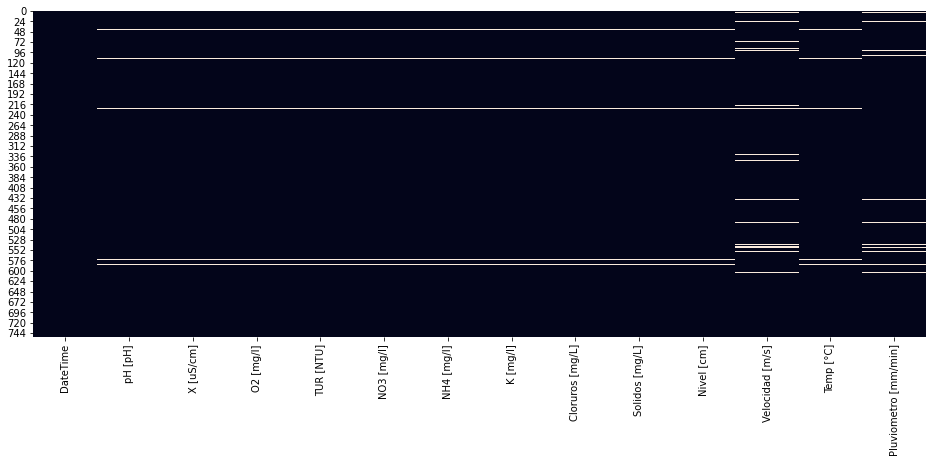

In [162]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_dia.isnull(), cbar=False)

In [163]:
df_dia["Velocidad [m/s]"].value_counts(dropna=False)

0.00    705
NaN      39
0.15      2
0.23      2
0.28      1
0.27      1
0.26      1
0.21      1
0.29      1
Name: Velocidad [m/s], dtype: int64

In [164]:
df_dia["Pluviometro [mm/min]"].value_counts(dropna=False)

0.0    721
NaN     31
1.0      1
Name: Pluviometro [mm/min], dtype: int64

In [165]:
# Eliminamos las filas con missing Values, se elimina todos los las filas NAN son las mismas en todas las columnas 
df_dia.dropna(subset=['pH [pH]'], inplace=True)

In [166]:
columnas_eliminar = ["Velocidad [m/s]", "Pluviometro [mm/min]"]
df_dia = df_dia.drop(columnas_eliminar, axis=1)

<AxesSubplot:>

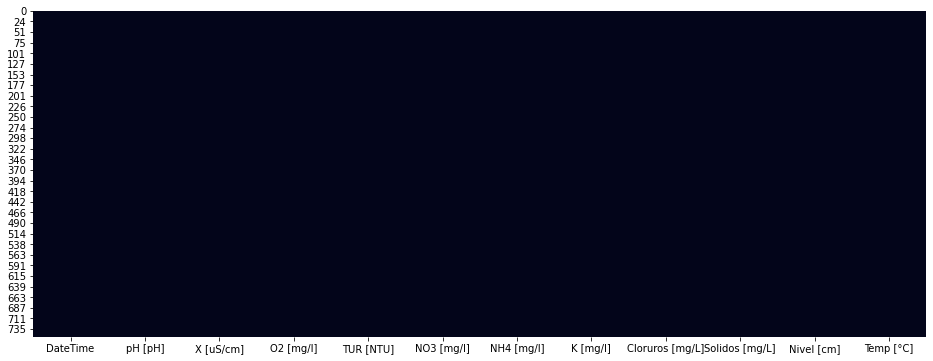

In [167]:
import seaborn as sns

# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_dia.isnull(), cbar=False)

In [168]:
df_dia.reset_index(drop=True, inplace=True)

In [169]:
columns_dia = list(df_dia.columns)
columns_dia = columns_dia[1:]

In [170]:
columns_dia

['pH [pH]',
 'X [uS/cm]',
 'O2 [mg/l]',
 'TUR [NTU]',
 'NO3 [mg/l]',
 'NH4 [mg/l]',
 'K [mg/l]',
 'Cloruros [mg/L]',
 'Solidos [mg/L]',
 'Nivel [cm]',
 'Temp [°C]']

In [171]:
columns_sin_espacios_dia = list()
for i in range(0,len(columns_dia)):
    columnSinEspacios = columns_dia[i].replace(" ", "")
    columnSinEspacios = columnSinEspacios.replace("[", "_")
    columnSinEspacios = columnSinEspacios.replace("]", "")
    columns_sin_espacios_dia.append(columnSinEspacios)

In [172]:
columns_sin_espacios_dia

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [173]:
for i in range(len(columns_sin_espacios_dia)):
    df_dia = df_dia.rename(columns={columns_dia[i]: columns_sin_espacios_dia[i]})

In [174]:
df_dia

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,2023-04-28 12:00:00,7.21,370.58,1.18,52.73,177.50,14.84,21.64,40.38,211.64,221.79,19.03
1,2023-04-28 12:05:00,7.19,367.68,0.90,51.57,171.44,15.01,22.76,38.99,208.63,222.69,18.76
2,2023-04-28 12:10:00,7.18,367.76,0.67,51.02,177.65,15.48,23.96,39.12,207.53,223.95,18.59
3,2023-04-28 12:15:00,7.17,368.73,0.53,50.13,177.01,15.64,24.54,37.61,206.22,227.40,18.46
4,2023-04-28 12:20:00,7.16,364.06,0.40,50.59,185.12,15.66,25.06,38.42,207.19,364.38,18.32
...,...,...,...,...,...,...,...,...,...,...,...,...
733,2023-05-01 05:40:00,7.12,359.81,0.03,55.47,134.15,18.21,41.12,55.85,214.39,420.48,16.90
734,2023-05-01 05:45:00,7.13,358.46,0.03,55.87,133.22,18.15,41.10,55.31,216.96,428.12,16.92
735,2023-05-01 05:50:00,7.13,360.80,0.03,55.81,134.26,18.10,41.22,55.75,216.18,413.43,16.92
736,2023-05-01 05:55:00,7.13,359.26,0.03,55.94,132.04,18.11,41.13,54.95,221.63,384.58,16.89


In [175]:
columns_dia = list(df_dia.columns)
columns_dia = columns_dia[1:]

In [176]:
for column in columns_dia:
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_dia[column], name = column), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Histogram(x=df_dia[column], nbinsx=100, name = "Histograma"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Graficas de violin de "+ column +" para bomba diafragma")

    # Mostrar la figura
    fig.show()


In [177]:
variables_z = list()
for column in columns_dia:
    variable_name = "z_" + column
    globals()[variable_name] = np.abs(stats.zscore(df_dia[column]))
    variables_z.append(variable_name)
variables_z


['z_pH_pH',
 'z_X_uS/cm',
 'z_O2_mg/l',
 'z_TUR_NTU',
 'z_NO3_mg/l',
 'z_NH4_mg/l',
 'z_K_mg/l',
 'z_Cloruros_mg/L',
 'z_Solidos_mg/L',
 'z_Nivel_cm',
 'z_Temp_°C']

In [178]:
variables_atipicos = list()
for i in range(len(columns_dia)):
    variable_name = "atp_" + columns_dia[i] + "_dia"
    globals()[variable_name] = (np.where(globals()[variables_z[i]] > 3))
    variables_atipicos.append(variable_name)
variables_atipicos


['atp_pH_pH_dia',
 'atp_X_uS/cm_dia',
 'atp_O2_mg/l_dia',
 'atp_TUR_NTU_dia',
 'atp_NO3_mg/l_dia',
 'atp_NH4_mg/l_dia',
 'atp_K_mg/l_dia',
 'atp_Cloruros_mg/L_dia',
 'atp_Solidos_mg/L_dia',
 'atp_Nivel_cm_dia',
 'atp_Temp_°C_dia']

In [179]:
atp_Nivel_cm_dia

(array([ 0,  1,  2,  3, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38],
       dtype=int64),)

In [180]:
dataframe_names_dia = list()
# Crear los DataFrames y asignarles nombres de variables
for i in range(len(columns_dia)):
    dataframe_name = f"df_sin_{variables_atipicos[i]}"
    globals()[dataframe_name] = df_dia[[columns_dia[i],"DateTime"]].drop(index = globals()[variables_atipicos[i]][0])
    dataframe_names_dia.append(dataframe_name)
dataframe_names_dia


['df_sin_atp_pH_pH_dia',
 'df_sin_atp_X_uS/cm_dia',
 'df_sin_atp_O2_mg/l_dia',
 'df_sin_atp_TUR_NTU_dia',
 'df_sin_atp_NO3_mg/l_dia',
 'df_sin_atp_NH4_mg/l_dia',
 'df_sin_atp_K_mg/l_dia',
 'df_sin_atp_Cloruros_mg/L_dia',
 'df_sin_atp_Solidos_mg/L_dia',
 'df_sin_atp_Nivel_cm_dia',
 'df_sin_atp_Temp_°C_dia']

In [181]:
for i in range(len(columns_dia)):
    globals()[dataframe_names_dia[i]].reset_index(drop=True, inplace=True)


In [182]:
#globals()[dataframe_names_dia[1]].values

# Comparacion diagrama de violin, con y sin datos atipicos

In [183]:
import plotly.io as pio
for i in range(len(columns_dia)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico (violin plot) en el primer subplot
    fig.add_trace(go.Violin(y=df_dia[columns_dia[i]], name="sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico (violin plot) en el segundo subplot
    fig.add_trace(go.Violin(y=globals()[dataframe_names_dia[i]].iloc[:, 0], name="con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Gráficas de violín de " + columns_dia[i] + " para bomba diafragma")

    # Mostrar la figura
    fig.show()
    

# Serie de tiempo para PH

In [184]:
for i in range(len(columns_dia)):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_dia['DateTime'], y=df_dia[columns_dia[i]], name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names_dia[i]].iloc[:, 1], y=globals()[dataframe_names_dia[i]].iloc[:, 0], name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns_dia[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

C:\Users\57314\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




# Modelos de Machine Learning 


Se puede utilizar una serie de tiempo para hacer predicciones de los valores futuros. El análisis de series de tiempo se enfoca en comprender y modelar la estructura temporal de los datos para poder hacer pronósticos.

Hay diferentes métodos y técnicas para realizar predicciones en series de tiempo. Algunas de las técnicas comunes incluyen:

Modelos de promedio móvil (MA): Estos modelos utilizan el promedio de observaciones pasadas para predecir valores futuros. Los modelos MA son útiles para datos que no muestran una tendencia o patrón claro.

Modelos autorregresivos (AR): Estos modelos se basan en regresiones lineales de los valores pasados para predecir los valores futuros. Los modelos AR son útiles para datos que muestran una tendencia o patrón autocorrelacionado.

Modelos ARIMA: Este es un modelo más complejo que combina componentes de los modelos MA y AR para modelar tanto la tendencia como la autocorrelación en los datos.

Modelos de suavizado exponencial: Estos modelos utilizan un promedio ponderado de los valores pasados para predecir los valores futuros. Son útiles cuando hay una tendencia y/o estacionalidad en los datos.

Redes neuronales recurrentes (RNN): Estos modelos son adecuados para capturar patrones complejos en los datos de series de tiempo. Las RNN, como las LSTM (Long Short-Term Memory), son populares para el pronóstico de series de tiempo.

La elección del método de predicción dependerá del tipo de datos, la presencia de tendencias, estacionalidad y otros factores. También es importante realizar una evaluación adecuada del modelo utilizando técnicas de validación y prueba.

En resumen, sí es posible utilizar una serie de tiempo para hacer predicciones de los valores futuros. Sin embargo, la elección del método y la precisión de las predicciones dependerán de la naturaleza de los datos y de la técnica utilizada.

# MODELO DE RNN PH

In [185]:
X = globals()[dataframe_names[0]].iloc[:,1]
y = globals()[dataframe_names[0]].iloc[:,0]

In [186]:
globals()[dataframe_names[0]].iloc[:,0]

0       7.18
1       7.18
2       7.18
3       7.18
4       7.18
        ... 
6581    7.13
6582    7.13
6583    7.13
6584    7.14
6585    7.14
Name: pH_pH, Length: 6586, dtype: float64

In [187]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

110    2023-04-01 09:20:00
2576   2023-04-13 01:30:00
2746   2023-04-13 16:40:00
1446   2023-04-08 10:35:00
1867   2023-04-09 22:45:00
               ...        
3772   2023-04-17 10:25:00
5191   2023-04-22 17:35:00
5226   2023-04-22 20:30:00
5390   2023-04-23 11:10:00
860    2023-04-06 07:40:00
Name: DateTime, Length: 5268, dtype: datetime64[ns]

In [70]:
# Reshape de los datos a una matriz 2D
X_train_reshaped = X_train.values.reshape(-1, 1)
X_test_reshaped = X_test.values.reshape(-1, 1)
X_train_reshaped

array([['2023-04-01T09:20:00.000000000'],
       ['2023-04-13T01:30:00.000000000'],
       ['2023-04-13T16:40:00.000000000'],
       ...,
       ['2023-04-22T20:30:00.000000000'],
       ['2023-04-23T11:10:00.000000000'],
       ['2023-04-06T07:40:00.000000000']], dtype='datetime64[ns]')

In [71]:
# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)
X_train_scaled

array([[0.01440514],
       [0.44681672],
       [0.47022508],
       ...,
       [0.80951768],
       [0.83215434],
       [0.1970418 ]])

In [72]:
# Crear el modelo de RNN
model = Sequential()
model.add(LSTM(10, activation='tanh', input_shape=(1, X_train_scaled.shape[1])))
model.add(Dense(3))

In [73]:
model.compile(loss='mean_squared_error', optimizer='adam')

In [74]:
model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)

Epoch 1/30
165/165 [==============================] - 3s 3ms/step - loss: 49.5374
Epoch 2/30
165/165 [==============================] - 1s 3ms/step - loss: 38.1882
Epoch 3/30
165/165 [==============================] - 0s 3ms/step - loss: 21.3730
Epoch 4/30
165/165 [==============================] - 0s 3ms/step - loss: 8.9511
Epoch 5/30
165/165 [==============================] - 1s 3ms/step - loss: 3.2149
Epoch 6/30
165/165 [==============================] - 0s 2ms/step - loss: 1.3009
Epoch 7/30
165/165 [==============================] - 0s 2ms/step - loss: 0.8006
Epoch 8/30
165/165 [==============================] - 0s 3ms/step - loss: 0.6697
Epoch 9/30
165/165 [==============================] - 0s 2ms/step - loss: 0.6079
Epoch 10/30
165/165 [==============================] - 0s 2ms/step - loss: 0.5567
Epoch 11/30
165/165 [==============================] - 0s 2ms/step - loss: 0.5079
Epoch 12/30
165/165 [==============================] - 0s 3ms/step - loss: 0.4608
Epoch 13/30
165/165 [=

In [75]:
loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)

42/42 [==============================] - 1s 2ms/step - loss: 0.0206
Pérdida en los datos de prueba: 0.02059064246714115


# GRAFICA original y prediccion bomba peristaltica

In [76]:
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]


In [77]:
df_combinado

,DateTime,pH_pH
0,2023-04-01 00:00:00,7.18
1,2023-04-01 00:05:00,7.18
2,2023-04-01 00:10:00,7.18
3,2023-04-01 00:15:00,7.18
4,2023-04-01 00:20:00,7.18
...,...,...
6581,2023-04-27 23:35:00,7.13
6582,2023-04-27 23:40:00,7.13
6583,2023-04-27 23:45:00,7.13
6584,2023-04-27 23:50:00,7.14


In [78]:
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

In [79]:
globals()[dataframe_names_dia[0]].iloc[:, 1]

0     2023-04-28 12:05:00
1     2023-04-28 12:10:00
2     2023-04-28 12:15:00
3     2023-04-28 12:20:00
4     2023-04-28 12:25:00
              ...        
732   2023-05-01 05:40:00
733   2023-05-01 05:45:00
734   2023-05-01 05:50:00
735   2023-05-01 05:55:00
736   2023-05-01 06:00:00
Name: DateTime, Length: 737, dtype: datetime64[ns]

In [80]:
X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

In [81]:
predictions = model.predict(X_scaled)

24/24 [==============================] - 1s 2ms/step


In [82]:
predictions

array([[6.9942245, 7.037512 , 7.0598183],
       [6.9953094, 7.0385256, 7.0607424],
       [6.9963913, 7.0395355, 7.0616636],
       ...,
       [7.3279643, 7.285034 , 7.2720585],
       [7.3279834, 7.284935 , 7.271929 ],
       [7.3280025, 7.284836 , 7.271799 ]], dtype=float32)

In [83]:
df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

In [84]:
df_combinado2

,DateTime,pH_pH
0,2023-04-28 12:05:00,6.994225
1,2023-04-28 12:10:00,6.995309
2,2023-04-28 12:15:00,6.996391
3,2023-04-28 12:20:00,6.997471
4,2023-04-28 12:25:00,6.998549
...,...,...
732,2023-05-01 05:40:00,7.327924
733,2023-05-01 05:45:00,7.327944
734,2023-05-01 05:50:00,7.327964
735,2023-05-01 05:55:00,7.327983


In [85]:
df_concatenado = pd.concat([df_combinado, df_combinado2])

In [86]:
df_concatenado.reset_index(drop=True, inplace=True)

In [87]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)


In [88]:
# Calcular las medias móviles utilizando pandas
window_sizes = [100, 200]  # Tamaños de las ventanas de las medias móviles

for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    df_concatenado[column_name] = df_concatenado['pH_pH'].rolling(window=window_size).mean()

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)

# Agregar las líneas de las medias móviles
for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[column_name], name=f'Media Móvil {window_size}'))

# Actualizar las propiedades de diseño del gráfico
fig.update_layout(title='Gráfico de Línea con Medias Móviles', xaxis_title='Fecha y Hora', yaxis_title='pH_pH')

# Mostrar el gráfico
fig.show()

# Entrenar varios modelos y elegir el mejor

In [ ]:
# Lista de parámetros a probar
parametros = [
    {'lstm_units': 50, 'activation': 'tanh'},
    {'lstm_units': 50, 'activation': 'relu'},
    {'lstm_units': 50, 'activation': 'sigmoid'},
    {'lstm_units': 100, 'activation': 'tanh'},
    {'lstm_units': 100, 'activation': 'relu'},
    {'lstm_units': 100, 'activation': 'sigmoid'},
    {'lstm_units': 200, 'activation': 'tanh'},
    {'lstm_units': 200, 'activation': 'relu'},
    {'lstm_units': 200, 'activation': 'sigmoid'}
]

# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')
# Configura la semilla para TensorFlow
tf.random.set_seed(42)

# Configura la semilla para NumPy (si lo estás utilizando en tu código)
np.random.seed(42)

# Luego, en tu código, antes de entrenar el modelo, configura la semilla de Python para obtener resultados reproducibles.

random.seed(42)

In [ ]:
# Bucle para entrenar y evaluar los modelos con diferentes parámetros
for params in parametros:
    # Crear el modelo de RNN
    model = Sequential()
    model.add(LSTM(params['lstm_units'], activation=params['activation'], input_shape=(1, X_train_scaled.shape[1])))
    model.add(Dense(3))

    # Compilar el modelo
    model.compile(loss='mean_squared_error', optimizer='adam')

    # Entrenar el modelo
    model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)
    
    # Evaluar el modelo en los datos de prueba
    loss = model.evaluate(X_test_scaled, y_test)

    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model
        

In [ ]:
print("Mejor pérdida:", best_loss)


In [ ]:
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]

In [ ]:
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

In [ ]:
X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

In [ ]:
# Utilizar el mejor modelo para hacer predicciones
predictions = best_model.predict(X_scaled)

In [ ]:
df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

In [ ]:
df_concatenado = pd.concat([df_combinado, df_combinado2])

In [ ]:
df_concatenado.reset_index(drop=True, inplace=True)

In [ ]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)


# Codigo completo Red Neuronal Recurrente

In [89]:
dataframe_names[8]

'df_sin_atp_atp_Solidos_mg/L'

In [90]:
columns

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

# Acreditados 'pH_pH',   X_uS/cm    , O2_mg/l,  'Temp_°C'

# Red neuronal solidos suspendidos

In [ ]:
X = globals()[dataframe_names[8]].iloc[:,1]
y = globals()[dataframe_names[8]].iloc[:,0]

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

# Reshape de los datos a una matriz 2D
X_train_reshaped = X_train.values.reshape(-1, 1)
X_test_reshaped = X_test.values.reshape(-1, 1)
X_train_reshaped

# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)
X_train_scaled

# Crear el modelo de RNN
model = Sequential()
model.add(LSTM(100, activation='tanh', input_shape=(1, X_train_scaled.shape[1])))
model.add(Dense(3))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)

#Calcular la Perdida
loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)

#Combinar los datos 
df_combinado = globals()[dataframe_names[8]][["DateTime", columns[8]]]
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[8]].iloc[:, 1]

X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

predictions = model.predict(X_scaled)

df_combinado2[columns[8]] = None
df_combinado2[columns[8]] = predictions

df_concatenado = pd.concat([df_combinado, df_combinado2])
df_concatenado.reset_index(drop=True, inplace=True)

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[columns[8]], name='Peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia[columns[8]], name='Diagragma'))
fig.add_traces(fig2.data)
# Actualizar las propiedades de diseño de la figura
fig.update_layout(width=950, height=400, title="Predciciones para  "+ columns[8] +" con Red Neuronal Recurrente")
# Mostrar el gráfico
fig.show()


# Todos las variables

In [ ]:
def train_and_plot_rnn(i):
    X = globals()[dataframe_names[i]].iloc[:,1]
    y = globals()[dataframe_names[i]].iloc[:,0]

    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    X_train

    # Reshape de los datos a una matriz 2D
    X_train_reshaped = X_train.values.reshape(-1, 1)
    X_test_reshaped = X_test.values.reshape(-1, 1)
    X_train_reshaped

    # Escalar los datos utilizando MinMaxScaler
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train_reshaped)
    X_test_scaled = scaler.transform(X_test_reshaped)
    X_train_scaled

    # Crear el modelo de RNN
    model = Sequential()
    model.add(LSTM(100, activation='sigmoid', input_shape=(1, X_train_scaled.shape[1])))
    model.add(Dense(3))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=0)

    #Calcular la Perdida
    loss = model.evaluate(X_test_scaled, y_test)
    print("Pérdida en los datos de prueba:", loss)

    #Combinar los datos 
    df_combinado = globals()[dataframe_names[i]][["DateTime", columns[i]]]
    df_combinado2 = pd.DataFrame()
    df_combinado2["DateTime"] = globals()[dataframe_names_dia[i]].iloc[:, 1]

    X = df_combinado2['DateTime']
    X = X.values.reshape(-1, 1)
    X_scaled = scaler.fit_transform(X)

    predictions = model.predict(X_scaled)

    df_combinado2[columns[i]] = None
    df_combinado2[columns[i]] = predictions

    df_concatenado = pd.concat([df_combinado, df_combinado2])
    df_concatenado.reset_index(drop=True, inplace=True)

    # Crear el gráfico de línea
    fig = go.Figure()
    fig2 = go.Figure()

    # Agregar la línea de datos originales
    fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[columns[i]], name='Peristaltica + prediccion'))
    fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia[columns[i]], name='Diagragma'))
    fig.add_traces(fig2.data)
    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Predicciones para  "+ columns[i] +" con Red Neuronal Recurrente")
    # Mostrar el gráfico
    fig.show()

In [ ]:
i = 0
train_and_plot_rnn(i)

In [ ]:
i = 1
train_and_plot_rnn(i)

In [ ]:
i = 2
train_and_plot_rnn(i)

In [ ]:
i = 3
train_and_plot_rnn(i)

In [ ]:
i = 4
train_and_plot_rnn(i)

In [ ]:
i = 5
train_and_plot_rnn(i)

In [ ]:
i = 6
train_and_plot_rnn(i)

In [ ]:
i = 7
train_and_plot_rnn(i)

In [ ]:
i = 8
train_and_plot_rnn(i)

In [ ]:
i = 9
train_and_plot_rnn(i)

In [ ]:
i = 10
train_and_plot_rnn(i)

In [ ]:
globals()[dataframe_names[0]][["DateTime", "pH_pH"]]

# Graficas 

In [ ]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=globals()[dataframe_names[0]]['DateTime'], y=globals()[dataframe_names[0]]['pH_pH'], name='Bomba Peristáltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de Diagragma'))
fig.add_traces(fig2.data)

# Nueva Red Neuronal, con modificacion del tiempo

1. Separar dias, minutos y horas y normalizar PH:

In [91]:
df_ph = df_sin_atp_atp_pH_pH.drop(['cluster_label'], axis=1)

In [92]:
# Crea una instancia de MinMaxScaler
scaler_ph = MinMaxScaler()

# Ajusta el scaler a los datos de la columna "PH" y transforma los valores
df_ph['pH_pH_s'] = scaler_ph.fit_transform(df_ph[['pH_pH']])

# Ahora, la columna "PH_normalizado" contiene los valores normalizados entre 0 y 1.

In [93]:
df_ph['Día'] = df_ph['DateTime'].dt.day
df_ph['Hora'] = df_ph['DateTime'].dt.hour
df_ph['Minutos'] = df_ph['DateTime'].dt.minute
df_ph

,pH_pH,DateTime,pH_pH_s,Día,Hora,Minutos
0,7.18,2023-04-01 00:00:00,0.443478,1,0,0
1,7.18,2023-04-01 00:05:00,0.443478,1,0,5
2,7.18,2023-04-01 00:10:00,0.443478,1,0,10
3,7.18,2023-04-01 00:15:00,0.443478,1,0,15
4,7.18,2023-04-01 00:20:00,0.443478,1,0,20
...,...,...,...,...,...,...
6581,7.13,2023-04-27 23:35:00,0.400000,27,23,35
6582,7.13,2023-04-27 23:40:00,0.400000,27,23,40
6583,7.13,2023-04-27 23:45:00,0.400000,27,23,45
6584,7.14,2023-04-27 23:50:00,0.408696,27,23,50


In [94]:
df_ph.iloc[:,3:6]

,Día,Hora,Minutos
0,1,0,0
1,1,0,5
2,1,0,10
3,1,0,15
4,1,0,20
...,...,...,...
6581,27,23,35
6582,27,23,40
6583,27,23,45
6584,27,23,50


In [95]:
df_ph.iloc[:,2]

0       0.443478
1       0.443478
2       0.443478
3       0.443478
4       0.443478
          ...   
6581    0.400000
6582    0.400000
6583    0.400000
6584    0.408696
6585    0.408696
Name: pH_pH_s, Length: 6586, dtype: float64

In [96]:
df_sin_atp_atp_pH_pH.iloc[:,1]

0      2023-04-01 00:00:00
1      2023-04-01 00:05:00
2      2023-04-01 00:10:00
3      2023-04-01 00:15:00
4      2023-04-01 00:20:00
               ...        
6581   2023-04-27 23:35:00
6582   2023-04-27 23:40:00
6583   2023-04-27 23:45:00
6584   2023-04-27 23:50:00
6585   2023-04-27 23:55:00
Name: DateTime, Length: 6586, dtype: datetime64[ns]

In [97]:
#ORIGINAAAAAAAAAAAAAAAAAAAAAAAAAL
X = df_sin_atp_atp_pH_pH.iloc[:,1]
y = df_sin_atp_atp_pH_pH.iloc[:,0]
globals()[dataframe_names[0]].iloc[:,0]
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train
# Reshape de los datos a una matriz 2D
X_train_reshaped = X_train.values.reshape(-1, 1)
X_test_reshaped = X_test.values.reshape(-1, 1)
X_train_reshaped
# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)
X_train_scaled
# Crear el modelo de RNN
model = Sequential()
model.add(LSTM(5, activation='tanh', input_shape=(1, X_train_scaled.shape[1])))
model.add(Dense(3))

model.compile(loss='mean_squared_error', optimizer='adam')

model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=1)

loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)



Epoch 1/50
165/165 [==============================] - 2s 2ms/step - loss: 49.7298
Epoch 2/50
165/165 [==============================] - 0s 2ms/step - loss: 42.3092
Epoch 3/50
165/165 [==============================] - 0s 2ms/step - loss: 31.7961
Epoch 4/50
165/165 [==============================] - 0s 2ms/step - loss: 21.0691
Epoch 5/50
165/165 [==============================] - 0s 3ms/step - loss: 12.8270
Epoch 6/50
165/165 [==============================] - 0s 3ms/step - loss: 7.4489
Epoch 7/50
165/165 [==============================] - 0s 2ms/step - loss: 4.1895
Epoch 8/50
165/165 [==============================] - 0s 2ms/step - loss: 2.3148
Epoch 9/50
165/165 [==============================] - 0s 3ms/step - loss: 1.2903
Epoch 10/50
165/165 [==============================] - 0s 2ms/step - loss: 0.7577
Epoch 11/50
165/165 [==============================] - 0s 2ms/step - loss: 0.4931
Epoch 12/50
165/165 [==============================] - 0s 2ms/step - loss: 0.3653
Epoch 13/50
165/165 

In [98]:
#ORIGINAAAAAAAAAAAAAAAAAAAAAAAAAL
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]

df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

predictions = model.predict(X_scaled)

df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

df_concatenado = pd.concat([df_combinado, df_combinado2])
df_concatenado.reset_index(drop=True, inplace=True)
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_combinado['DateTime'], y=df_combinado['pH_pH'], name='Bomba peristaltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig3.add_trace(go.Scatter(x=df_combinado2['DateTime'], y=df_combinado2['pH_pH'], name='Prediccion'))

fig.add_traces(fig2.data)
fig.add_traces(fig3.data)


24/24 [==============================] - 0s 2ms/step


In [104]:
tf.random.set_seed(42)
np.random.seed(42)
random.seed(42)

# Seleccionar las columnas 2 a 4 como características de entrada X
X = df_ph.iloc[:, 3:6]
# Seleccionar la columna 0 como la variable objetivo y
y = df_ph.iloc[:, 2]
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reorganizar los datos para que sean 3D (muestras, pasos de tiempo, características)
X_train_scaled_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_test_scaled_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

# Crear el modelo de red neuronal sin LSTM
model = Sequential()
model.add(Dense(5, activation='tanh', input_shape=(X_train_scaled.shape[1],)))
model.add(Dense(1))

model.compile(loss='mean_squared_error', optimizer='adam')

model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=1)

loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)

Epoch 1/50
165/165 [==============================] - 1s 1ms/step - loss: 0.0471
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0186
Epoch 3/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0159
Epoch 4/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0147
Epoch 5/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0143
Epoch 6/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0141
Epoch 7/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 8/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 9/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 10/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 11/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 12/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 13/50
165/165 [====

In [105]:
X_train_scaled

array([[0.        , 0.39130435, 0.36363636],
       [0.46153846, 0.04347826, 0.54545455],
       [0.46153846, 0.69565217, 0.72727273],
       ...,
       [0.80769231, 0.86956522, 0.54545455],
       [0.84615385, 0.47826087, 0.18181818],
       [0.19230769, 0.30434783, 0.72727273]])

In [106]:
df_ph_pred = pd.DataFrame()
df_ph_pred["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

In [107]:
df_ph_pred

,DateTime
0,2023-04-28 12:05:00
1,2023-04-28 12:10:00
2,2023-04-28 12:15:00
3,2023-04-28 12:20:00
4,2023-04-28 12:25:00
...,...
732,2023-05-01 05:40:00
733,2023-05-01 05:45:00
734,2023-05-01 05:50:00
735,2023-05-01 05:55:00


In [108]:
df_ph_pred['Día'] = df_ph_pred['DateTime'].dt.day
df_ph_pred['Hora'] = df_ph_pred['DateTime'].dt.hour
df_ph_pred['Minutos'] = df_ph_pred['DateTime'].dt.minute
df_ph_pred

,DateTime,Día,Hora,Minutos
0,2023-04-28 12:05:00,28,12,5
1,2023-04-28 12:10:00,28,12,10
2,2023-04-28 12:15:00,28,12,15
3,2023-04-28 12:20:00,28,12,20
4,2023-04-28 12:25:00,28,12,25
...,...,...,...,...
732,2023-05-01 05:40:00,1,5,40
733,2023-05-01 05:45:00,1,5,45
734,2023-05-01 05:50:00,1,5,50
735,2023-05-01 05:55:00,1,5,55


In [109]:
df_ph_pred.iloc[:, 1:4]

,Día,Hora,Minutos
0,28,12,5
1,28,12,10
2,28,12,15
3,28,12,20
4,28,12,25
...,...,...,...
732,1,5,40
733,1,5,45
734,1,5,50
735,1,5,55


In [110]:
X = df_ph_pred.iloc[:, 1:4]
X_scaled = scaler.fit_transform(X)

In [111]:
X_scaled

array([[0.93103448, 0.52173913, 0.09090909],
       [0.93103448, 0.52173913, 0.18181818],
       [0.93103448, 0.52173913, 0.27272727],
       ...,
       [0.        , 0.2173913 , 0.90909091],
       [0.        , 0.2173913 , 1.        ],
       [0.        , 0.26086957, 0.        ]])

In [112]:
predictions = model.predict(X_scaled)

df_ph_pred["pH_pH_s"] = None
df_ph_pred["pH_pH_s"] = predictions

24/24 [==============================] - 0s 998us/step


In [113]:
df_ph_pred["pH_pH_s"] = model.predict(X_scaled)

24/24 [==============================] - 0s 1ms/step


In [114]:
df_ph_pred["pH_pH_s"] = None

In [115]:
df_ph_pred

,DateTime,Día,Hora,Minutos,pH_pH_s
0,2023-04-28 12:05:00,28,12,5,None
1,2023-04-28 12:10:00,28,12,10,None
2,2023-04-28 12:15:00,28,12,15,None
3,2023-04-28 12:20:00,28,12,20,None
4,2023-04-28 12:25:00,28,12,25,None
...,...,...,...,...,...
732,2023-05-01 05:40:00,1,5,40,None
733,2023-05-01 05:45:00,1,5,45,None
734,2023-05-01 05:50:00,1,5,50,None
735,2023-05-01 05:55:00,1,5,55,None


In [116]:
df_ph_pred['pH_pH'] = scaler_ph.inverse_transform(df_ph_pred[['pH_pH_s']])
df_ph_pred

,DateTime,Día,Hora,Minutos,pH_pH_s,pH_pH
0,2023-04-28 12:05:00,28,12,5,None,NaN
1,2023-04-28 12:10:00,28,12,10,None,NaN
2,2023-04-28 12:15:00,28,12,15,None,NaN
3,2023-04-28 12:20:00,28,12,20,None,NaN
4,2023-04-28 12:25:00,28,12,25,None,NaN
...,...,...,...,...,...,...
732,2023-05-01 05:40:00,1,5,40,None,NaN
733,2023-05-01 05:45:00,1,5,45,None,NaN
734,2023-05-01 05:50:00,1,5,50,None,NaN
735,2023-05-01 05:55:00,1,5,55,None,NaN


In [189]:
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_ph['DateTime'], y=df_ph['pH_pH'], name='Bomba peristaltica'))
fig2.add_trace(go.Scatter(x=df_ph_pred['DateTime'], y=df_ph_pred['pH_pH'], name='Prediccion'))
fig3.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Dia'))

fig.add_traces(fig2.data)
fig.add_traces(fig3.data)


Todo el codigo:

In [188]:
df_ph = df_sin_atp_atp_pH_pH.drop(['cluster_label'], axis=1)
# Crea una instancia de MinMaxScaler
scaler_ph = MinMaxScaler()
# Ajusta el scaler a los datos de la columna "PH" y transforma los valores
df_ph['pH_pH_s'] = scaler_ph.fit_transform(df_ph[['pH_pH']])
# Ahora, la columna "PH_normalizado" contiene los valores normalizados entre 0 y 1.
df_ph['Día'] = df_ph['DateTime'].dt.day
df_ph['Hora'] = df_ph['DateTime'].dt.hour
df_ph['Minutos'] = df_ph['DateTime'].dt.minute
# Seleccionar las columnas 2 a 4 como características de entrada 
X = df_ph.iloc[:, 3:6]
# Seleccionar la columna 0 como la variable objetivo y
y = df_ph.iloc[:, 2]
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reorganizar los datos para que sean 3D (muestras, pasos de tiempo, características)
X_train_scaled_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_test_scaled_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

# Crear el modelo de red neuronal sin LSTM
model = Sequential()
model.add(Dense(5, activation='tanh', input_shape=(X_train_scaled.shape[1],)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=1)
loss = model.evaluate(X_test_scaled, y_test)
df_ph_pred = pd.DataFrame()
df_ph_pred["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]	
df_ph_pred['Día'] = df_ph_pred['DateTime'].dt.day
df_ph_pred['Hora'] = df_ph_pred['DateTime'].dt.hour
df_ph_pred['Minutos'] = df_ph_pred['DateTime'].dt.minute
X = df_ph_pred.iloc[:, 1:4]
X_scaled = scaler.fit_transform(X)

df_ph_pred["pH_pH_s"] = model.predict(X_scaled)

df_ph_pred['pH_pH'] = scaler_ph.inverse_transform(df_ph_pred[['pH_pH_s']])
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_ph['DateTime'], y=df_ph['pH_pH'], name='Bomba Peristáltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba Diafragma'))
fig3.add_trace(go.Scatter(x=df_ph_pred['DateTime'], y=df_ph_pred['pH_pH'], name='Predicción'))


fig.add_traces(fig2.data)
fig.add_traces(fig3.data)


Epoch 1/50
165/165 [==============================] - 1s 1ms/step - loss: 0.0959
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0250
Epoch 3/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0165
Epoch 4/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0151
Epoch 5/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0145
Epoch 6/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0142
Epoch 7/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0141
Epoch 8/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 9/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 10/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 11/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 12/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0138
Epoch 13/50
165/165 [====

# Probar varios modelos Modelos PH 

In [191]:
parametros = [
    {'Densidad': 5, 'activation': 'tanh'},
    {'Densidad': 5, 'activation': 'sigmoid'},
    {'Densidad': 5, 'activation': 'relu',},
    {'Densidad': 20, 'activation': 'tanh'},
    {'Densidad': 20, 'activation': 'sigmoid'},
    {'Densidad': 20, 'activation': 'relu'},
    {'Densidad': 80, 'activation': 'tanh'},
    {'Densidad': 80, 'activation': 'relu'},
    {'Densidad': 80, 'activation': 'sigmoid'}
]
# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')


In [192]:
df_ph = df_sin_atp_atp_pH_pH.drop(['cluster_label'], axis=1)
# Crea una instancia de MinMaxScaler
scaler_ph = MinMaxScaler()
# Ajusta el scaler a los datos de la columna "PH" y transforma los valores
df_ph['pH_pH_s'] = scaler_ph.fit_transform(df_ph[['pH_pH']])
# Ahora, la columna "PH_normalizado" contiene los valores normalizados entre 0 y 1.
df_ph['Día'] = df_ph['DateTime'].dt.day
df_ph['Hora'] = df_ph['DateTime'].dt.hour
df_ph['Minutos'] = df_ph['DateTime'].dt.minute
# Dataframe de predicciones
df_ph_pred = pd.DataFrame()
df_ph_pred["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]
df_ph_pred['Día'] = df_ph_pred['DateTime'].dt.day
df_ph_pred['Hora'] = df_ph_pred['DateTime'].dt.hour
df_ph_pred['Minutos'] = df_ph_pred['DateTime'].dt.minute

In [193]:
for params in parametros:
    
    # Seleccionar las columnas 2 a 4 como características de entrada 
    X = df_ph.iloc[:, 3:6]
    # Seleccionar la columna 0 como la variable objetivo y
    y = df_ph.iloc[:, 2]
    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Escalar los datos utilizando MinMaxScaler
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Reorganizar los datos para que sean 3D (muestras, pasos de tiempo, características)
    X_train_scaled_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
    X_test_scaled_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

    # Crear el modelo de red neuronal sin LSTM
    model = Sequential()
    model.add(Dense(params['Densidad'], activation=params['activation'], input_shape=(X_train_scaled.shape[1],)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=1)
    loss = model.evaluate(X_test_scaled, y_test)
    
    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model
        

Epoch 1/50
165/165 [==============================] - 1s 1ms/step - loss: 0.0471
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0186
Epoch 3/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0159
Epoch 4/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0147
Epoch 5/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0143
Epoch 6/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0141
Epoch 7/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 8/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 9/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 10/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 11/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 12/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 13/50
165/165 [====

42/42 [==============================] - 0s 933us/step - loss: 0.0124
Epoch 1/50
165/165 [==============================] - 1s 1ms/step - loss: 0.0573
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0261
Epoch 3/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0196
Epoch 4/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0168
Epoch 5/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0154
Epoch 6/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0146
Epoch 7/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0141
Epoch 8/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0137
Epoch 9/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0133
Epoch 10/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0130
Epoch 11/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0127
Epoch 12/50
165/165 [================

165/165 [==============================] - 0s 1ms/step - loss: 0.0138
Epoch 49/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0138
Epoch 50/50
42/42 [==============================] - 0s 986us/step - loss: 0.0125
Epoch 1/50
165/165 [==============================] - 1s 1ms/step - loss: 0.0718
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0149
Epoch 3/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0145
Epoch 4/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0142
Epoch 5/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0141
Epoch 6/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 7/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 8/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 9/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 10/50
165/165 [================

165/165 [==============================] - 0s 1ms/step - loss: 0.0130
Epoch 47/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0130
Epoch 48/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0130
Epoch 49/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0130
Epoch 50/50
42/42 [==============================] - 0s 975us/step - loss: 0.0117
Epoch 1/50
165/165 [==============================] - 1s 2ms/step - loss: 0.0184
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0142
Epoch 3/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0141
Epoch 4/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0143
Epoch 5/50
165/165 [==============================] - 0s 961us/step - loss: 0.0141
Epoch 6/50
165/165 [==============================] - 0s 985us/step - loss: 0.0142
Epoch 7/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0143
Epoch 8/50
165/165 [===========

165/165 [==============================] - 0s 2ms/step - loss: 0.0082
Epoch 45/50
165/165 [==============================] - 0s 2ms/step - loss: 0.0081
Epoch 46/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0080
Epoch 47/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0081
Epoch 48/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0079
Epoch 49/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0080
Epoch 50/50
42/42 [==============================] - 0s 984us/step - loss: 0.0076
Epoch 1/50
165/165 [==============================] - 1s 1ms/step - loss: 0.0369
Epoch 2/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0141
Epoch 3/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 4/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 5/50
165/165 [==============================] - 0s 1ms/step - loss: 0.0140
Epoch 6/50
165/165 [=============

In [194]:
X = df_ph_pred.iloc[:, 1:4]
X_scaled = scaler.fit_transform(X)

df_ph_pred["pH_pH_s"] = best_model.predict(X_scaled)
df_ph_pred['pH_pH'] = scaler_ph.inverse_transform(df_ph_pred[['pH_pH_s']])

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_ph['DateTime'], y=df_ph['pH_pH'], name='Bomba Peristáltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba Diafragma'))
fig3.add_trace(go.Scatter(x=df_ph_pred['DateTime'], y=df_ph_pred['pH_pH'], name='Predicción'))


fig.add_traces(fig2.data)
fig.add_traces(fig3.data)


24/24 [==============================] - 0s 1ms/step


Conocer los parametros usados

In [195]:
# Obtener la configuración de capas y parámetros del modelo
model_config = best_model.get_config()
# Imprimir la configuración de capas y parámetros
print(model_config)
# También puedes obtener una descripción más detallada del modelo
model_summary = best_model.summary()
print(model_summary)

{'name': 'sequential_12', 'layers': [{'class_name': 'InputLayer', 'config': {'batch_input_shape': (None, 3), 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'dense_22_input'}}, {'class_name': 'Dense', 'config': {'name': 'dense_22', 'trainable': True, 'dtype': 'float32', 'batch_input_shape': (None, 3), 'units': 80, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}}, {'class_name': 'Dense', 'config': {'name': 'dense_23', 'trainable': True, 'dtype': 'float32', 'units': 1, 'activation': 'linear', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_

# Red Nuronal para oxigeno

In [234]:
dataframe_names[2]
globals()[dataframe_names[2]]

,O2_mg/l,DateTime,cluster_label
0,0.02,2023-04-01 00:00:00,2
1,0.02,2023-04-01 00:05:00,2
2,0.02,2023-04-01 00:10:00,2
3,0.03,2023-04-01 00:15:00,2
4,0.03,2023-04-01 00:20:00,2
...,...,...,...
6398,0.03,2023-04-27 23:35:00,2
6399,0.03,2023-04-27 23:40:00,2
6400,0.03,2023-04-27 23:45:00,2
6401,0.03,2023-04-27 23:50:00,2


In [258]:
parametros = [
    {'Neuronas': 10, 'activation': 'tanh'},
    {'Neuronas': 10, 'activation': 'sigmoid'},
    {'Neuronas': 10, 'activation': 'relu',},
    {'Neuronas': 30, 'activation': 'tanh'},
    {'Neuronas': 30, 'activation': 'sigmoid'},
    {'Neuronas': 30, 'activation': 'relu'},
    {'Neuronas': 60, 'activation': 'tanh'},
    {'Neuronas': 60, 'activation': 'relu'},
    {'Neuronas': 60, 'activation': 'sigmoid'}
]
# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')
df_o = globals()[dataframe_names[2]].drop(['cluster_label'], axis=1)
# Crea una instancia de MinMaxScaler
scaler_o = MinMaxScaler()
# Ajusta el scaler a los datos de la columna "O" y transforma los valores
df_o['O2_mg/l_s'] = scaler_o.fit_transform(df_o[['O2_mg/l']])
# Ahora, la columna "PH_normalizado" contiene los valores normalizados entre 0 y 1.
df_o['Día'] = df_o['DateTime'].dt.day
df_o['Hora'] = df_o['DateTime'].dt.hour
df_o['Minutos'] = df_o['DateTime'].dt.minute
# Dataframe de predicciones
df_o_pred = pd.DataFrame()
df_o_pred["DateTime"] = globals()[dataframe_names_dia[2]].iloc[:, 1]
df_o_pred['Día'] = df_o_pred['DateTime'].dt.day
df_o_pred['Hora'] = df_o_pred['DateTime'].dt.hour
df_o_pred['Minutos'] = df_o_pred['DateTime'].dt.minute

In [259]:
for params in parametros:
    
    # Seleccionar las columnas 2 a 4 como características de entrada 
    X = df_o.iloc[:, 4:6]
    # Seleccionar la columna 0 como la variable objetivo y
    y = df_o.iloc[:, 2]
    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Escalar los datos utilizando MinMaxScaler
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Reorganizar los datos para que sean 3D (muestras, pasos de tiempo, características)
    X_train_scaled_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
    X_test_scaled_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

    # Crear el modelo de red neuronal sin LSTM
    model = Sequential()
    model.add(Dense(params['Neuronas'], activation=params['activation'], input_shape=(X_train_scaled.shape[1],)))
    model.add(Dense(params['Neuronas'], activation=params['activation']))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train_scaled, y_train, epochs=80, batch_size=64, verbose=1)
    loss = model.evaluate(X_test_scaled, y_test)
    
    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model
        

Epoch 1/80
81/81 [==============================] - 1s 2ms/step - loss: 0.0390
Epoch 2/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0130
Epoch 3/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0116
Epoch 4/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0113
Epoch 5/80
81/81 [==============================] - 0s 3ms/step - loss: 0.0113
Epoch 6/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0112
Epoch 7/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0112
Epoch 8/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0114
Epoch 9/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0112
Epoch 10/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0112
Epoch 11/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0111
Epoch 12/80
81/81 [==============================] - 0s 3ms/step - loss: 0.0111
Epoch 13/80
81/81 [==============================

81/81 [==============================] - 0s 3ms/step - loss: 0.0114
Epoch 23/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0114
Epoch 24/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0115
Epoch 25/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0114
Epoch 26/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0114
Epoch 27/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0114
Epoch 28/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0115
Epoch 29/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0115
Epoch 30/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0115
Epoch 31/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0115
Epoch 32/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0114
Epoch 33/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0114
Epoch 34/80
81/81 [==============================] -

81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 44/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 45/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 46/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 47/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0103
Epoch 48/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0103
Epoch 49/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 50/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 51/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 52/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 53/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 54/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 55/80
81/81 [==============================] -

81/81 [==============================] - 0s 1ms/step - loss: 0.0107
Epoch 65/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 66/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 67/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 68/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 69/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 70/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 71/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 72/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 73/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 74/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 75/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 76/80
81/81 [==============================] -

Epoch 5/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0107
Epoch 6/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 7/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0106
Epoch 8/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0107
Epoch 9/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 10/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 11/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0104
Epoch 12/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 13/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 14/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 15/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 16/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0103
Epoch 17/80
81/81 [==========================

81/81 [==============================] - 0s 1ms/step - loss: 0.0107
Epoch 27/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 28/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0106
Epoch 29/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0106
Epoch 30/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0106
Epoch 31/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0110
Epoch 32/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0106
Epoch 33/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0106
Epoch 34/80
81/81 [==============================] - 0s 2ms/step - loss: 0.0105
Epoch 35/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 36/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 37/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0105
Epoch 38/80
81/81 [==============================] -

81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 48/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 49/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 50/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 51/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 52/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 53/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 54/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 55/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 56/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 57/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 58/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0102
Epoch 59/80
81/81 [==============================] -

81/81 [==============================] - 0s 1ms/step - loss: 0.0116
Epoch 69/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0117
Epoch 70/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0119
Epoch 71/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0119
Epoch 72/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0117
Epoch 73/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0117
Epoch 74/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0118
Epoch 75/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0117
Epoch 76/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0115
Epoch 77/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0118
Epoch 78/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0117
Epoch 79/80
81/81 [==============================] - 0s 1ms/step - loss: 0.0118
Epoch 80/80
41/41 [==============================] -

In [260]:
X = df_o_pred.iloc[:, 2:4]
X_scaled = scaler.fit_transform(X)

df_o_pred["O2_mg/l_s"] = best_model.predict(X_scaled)
df_o_pred['O2_mg/l'] = scaler_o.inverse_transform(df_o_pred[['O2_mg/l_s']])

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_o['DateTime'], y=df_o['O2_mg/l'], name='Bomba Peristáltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['O2_mg/l'], name='Bomba Diafragma'))
fig3.add_trace(go.Scatter(x=df_o_pred['DateTime'], y=df_o_pred['O2_mg/l'], name='Predicción'))


fig.add_traces(fig2.data)
fig.add_traces(fig3.data)


23/23 [==============================] - 0s 1ms/step


In [261]:
# Obtener la configuración de capas y parámetros del modelo
model_config = best_model.get_config()
# Imprimir la configuración de capas y parámetros
print(model_config)
# También puedes obtener una descripción más detallada del modelo
model_summary = best_model.summary()
print(model_summary)

{'name': 'sequential_139', 'layers': [{'class_name': 'InputLayer', 'config': {'batch_input_shape': (None, 2), 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'dense_308_input'}}, {'class_name': 'Dense', 'config': {'name': 'dense_308', 'trainable': True, 'dtype': 'float32', 'batch_input_shape': (None, 2), 'units': 60, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}}, {'class_name': 'Dense', 'config': {'name': 'dense_309', 'trainable': True, 'dtype': 'float32', 'units': 60, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activi

# Red Neuronal conductividad

In [196]:
globals()[dataframe_names[1]]

,X_uS/cm,DateTime,cluster_label
0,407.24,2023-04-01 00:00:00,2
1,409.09,2023-04-01 00:05:00,2
2,406.30,2023-04-01 00:10:00,2
3,407.02,2023-04-01 00:15:00,2
4,407.50,2023-04-01 00:20:00,2
...,...,...,...
6540,428.59,2023-04-27 23:35:00,2
6541,432.81,2023-04-27 23:40:00,2
6542,431.19,2023-04-27 23:45:00,2
6543,427.31,2023-04-27 23:50:00,2


In [197]:
parametros = [
    {'Densidad': 5, 'activation': 'tanh'},
    {'Densidad': 5, 'activation': 'sigmoid'},
    {'Densidad': 5, 'activation': 'relu',},
    {'Densidad': 25, 'activation': 'tanh'},
    {'Densidad': 25, 'activation': 'sigmoid'},
    {'Densidad': 25, 'activation': 'relu'},
    {'Densidad': 100, 'activation': 'tanh'},
    {'Densidad': 100, 'activation': 'relu'},
    {'Densidad': 100, 'activation': 'sigmoid'},
    {'Densidad': 200, 'activation': 'tanh'},
    {'Densidad': 200, 'activation': 'relu'},
    {'Densidad': 200, 'activation': 'sigmoid'},
    {'Densidad': 300, 'activation': 'tanh'},
    {'Densidad': 300, 'activation': 'relu'},
    {'Densidad': 300, 'activation': 'sigmoid'},
    {'Densidad': 3, 'activation': 'tanh'},
    {'Densidad': 3, 'activation': 'relu'},
    {'Densidad': 3, 'activation': 'sigmoid'}
]
# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')
df_x = globals()[dataframe_names[1]].drop(['cluster_label'], axis=1)
# Crea una instancia de MinMaxScaler
scaler_x = MinMaxScaler()
# Ajusta el scaler a los datos de la columna "PH" y transforma los valores
df_x['X_uS/cm_s'] = scaler_x.fit_transform(df_x[['X_uS/cm']])
# Ahora, la columna "PH_normalizado" contiene los valores normalizados entre 0 y 1.
df_x['Día'] = df_x['DateTime'].dt.day
df_x['Hora'] = df_x['DateTime'].dt.hour
df_x['Minutos'] = df_x['DateTime'].dt.minute
# Dataframe de predicciones
df_x_pred = pd.DataFrame()
df_x_pred["DateTime"] = globals()[dataframe_names_dia[1]].iloc[:, 1]
df_x_pred['Día'] = df_x_pred['DateTime'].dt.day
df_x_pred['Hora'] = df_x_pred['DateTime'].dt.hour
df_x_pred['Minutos'] = df_x_pred['DateTime'].dt.minute

In [198]:
for params in parametros:
    
    # Seleccionar las columnas 2 a 4 como características de entrada 
    X = df_x.iloc[:, 3:6]
    # Seleccionar la columna 0 como la variable objetivo y
    y = df_x.iloc[:, 2]
    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Escalar los datos utilizando MinMaxScaler
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Reorganizar los datos para que sean 3D (muestras, pasos de tiempo, características)
    X_train_scaled_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
    X_test_scaled_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

    # Crear el modelo de red neuronal sin LSTM
    model = Sequential()
    model.add(Dense(params['Densidad'], activation=params['activation'], input_shape=(X_train_scaled.shape[1],)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train_scaled, y_train, epochs=100, batch_size=50, verbose=1) #e=50 b_s = 32
    loss = model.evaluate(X_test_scaled, y_test)
    
    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model    

Epoch 1/100
105/105 [==============================] - 1s 2ms/step - loss: 0.1290
Epoch 2/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0716
Epoch 3/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0434
Epoch 4/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0301
Epoch 5/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0243
Epoch 6/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0222
Epoch 7/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0215
Epoch 8/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0212
Epoch 9/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0211
Epoch 10/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0210
Epoch 11/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0209
Epoch 12/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0208
Epoch 13/100


105/105 [==============================] - 0s 1ms/step - loss: 0.0178
Epoch 100/100
41/41 [==============================] - 0s 1ms/step - loss: 0.0179
Epoch 1/100
105/105 [==============================] - 1s 1ms/step - loss: 0.0410
Epoch 2/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0295
Epoch 3/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0275
Epoch 4/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0256
Epoch 5/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0240
Epoch 6/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0228
Epoch 7/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0220
Epoch 8/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0213
Epoch 9/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0210
Epoch 10/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0207
Epoch 11/100
105/105 [=====

Epoch 97/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 98/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 99/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 100/100
41/41 [==============================] - 0s 930us/step - loss: 0.0210
Epoch 1/100
105/105 [==============================] - 1s 1ms/step - loss: 0.1421
Epoch 2/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0568
Epoch 3/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0476
Epoch 4/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0407
Epoch 5/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0352
Epoch 6/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0307
Epoch 7/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0273
Epoch 8/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0247
Epoch 9/100

Epoch 95/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0173
Epoch 96/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0172
Epoch 97/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0172
Epoch 98/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0173
Epoch 99/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0172
Epoch 100/100
41/41 [==============================] - 0s 902us/step - loss: 0.0172
Epoch 1/100
105/105 [==============================] - 1s 982us/step - loss: 0.0417
Epoch 2/100
105/105 [==============================] - 0s 984us/step - loss: 0.0218
Epoch 3/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 4/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 5/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 6/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch

105/105 [==============================] - 0s 1ms/step - loss: 0.0175
Epoch 93/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0177
Epoch 94/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0174
Epoch 95/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0175
Epoch 96/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0175
Epoch 97/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0175
Epoch 98/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0174
Epoch 99/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0174
Epoch 100/100
41/41 [==============================] - 0s 2ms/step - loss: 0.0173
Epoch 1/100
105/105 [==============================] - 1s 1ms/step - loss: 0.2504
Epoch 2/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0396
Epoch 3/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0361
Epoch 4/100
105/105 [

105/105 [==============================] - 0s 2ms/step - loss: 0.0204
Epoch 91/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 92/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 93/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 94/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 95/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 96/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 97/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 98/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 99/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 100/100
41/41 [==============================] - 0s 972us/step - loss: 0.0210
Epoch 1/100
105/105 [==============================] - 1s 1ms/step - loss: 0.0948
Epoch 2/100
105/1

105/105 [==============================] - 0s 1ms/step - loss: 0.0124
Epoch 89/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0123
Epoch 90/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0123
Epoch 91/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0122
Epoch 92/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0121
Epoch 93/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0122
Epoch 94/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0120
Epoch 95/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0119
Epoch 96/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0117
Epoch 97/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0116
Epoch 98/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0115
Epoch 99/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0114
Epoch 100/100
41/

105/105 [==============================] - 0s 1ms/step - loss: 0.0198
Epoch 87/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0198
Epoch 88/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0199
Epoch 89/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0197
Epoch 90/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0197
Epoch 91/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0195
Epoch 92/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0194
Epoch 93/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0197
Epoch 94/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0193
Epoch 95/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0193
Epoch 96/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0192
Epoch 97/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0192
Epoch 98/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0101
Epoch 85/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0101
Epoch 86/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0100
Epoch 87/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0099
Epoch 88/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0100
Epoch 89/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0098
Epoch 90/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0098
Epoch 91/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0097
Epoch 92/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0096
Epoch 93/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0097
Epoch 94/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0096
Epoch 95/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0095
Epoch 96/100
105/

105/105 [==============================] - 0s 2ms/step - loss: 0.0205
Epoch 83/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0204
Epoch 84/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0206
Epoch 85/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0206
Epoch 86/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0204
Epoch 87/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0207
Epoch 88/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0212
Epoch 89/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0212
Epoch 90/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0204
Epoch 91/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0205
Epoch 92/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0203
Epoch 93/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0205
Epoch 94/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 81/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 82/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 83/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 84/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 85/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 86/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 87/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 88/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 89/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0202
Epoch 90/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0203
Epoch 91/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0201
Epoch 92/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0092
Epoch 79/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0092
Epoch 80/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0092
Epoch 81/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0092
Epoch 82/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0090
Epoch 83/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0090
Epoch 84/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0088
Epoch 85/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0089
Epoch 86/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0088
Epoch 87/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0087
Epoch 88/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0089
Epoch 89/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0088
Epoch 90/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0210
Epoch 77/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0206
Epoch 78/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 79/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 80/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 81/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 82/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0202
Epoch 83/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 84/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0204
Epoch 85/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 86/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 87/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 88/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 75/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 76/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 77/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 78/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 79/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 80/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 81/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0203
Epoch 82/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 83/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 84/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 85/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 86/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0085
Epoch 73/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0085
Epoch 74/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0084
Epoch 75/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0086
Epoch 76/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0084
Epoch 77/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0085
Epoch 78/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0081
Epoch 79/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0083
Epoch 80/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0083
Epoch 81/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0083
Epoch 82/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0081
Epoch 83/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0080
Epoch 84/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0212
Epoch 71/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0208
Epoch 72/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0207
Epoch 73/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0204
Epoch 74/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0207
Epoch 75/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0211
Epoch 76/100
105/105 [==============================] - 0s 3ms/step - loss: 0.0203
Epoch 77/100
105/105 [==============================] - 0s 3ms/step - loss: 0.0207
Epoch 78/100
105/105 [==============================] - 0s 3ms/step - loss: 0.0203
Epoch 79/100
105/105 [==============================] - 0s 3ms/step - loss: 0.0202
Epoch 80/100
105/105 [==============================] - 0s 2ms/step - loss: 0.0206
Epoch 81/100
105/105 [==============================] - 0s 3ms/step - loss: 0.0203
Epoch 82/100
105/

105/105 [==============================] - 0s 2ms/step - loss: 0.0192
Epoch 69/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0192
Epoch 70/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0192
Epoch 71/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0192
Epoch 72/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0191
Epoch 73/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0191
Epoch 74/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0191
Epoch 75/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0191
Epoch 76/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0190
Epoch 77/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0190
Epoch 78/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0190
Epoch 79/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0190
Epoch 80/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0164
Epoch 67/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0163
Epoch 68/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0163
Epoch 69/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 70/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 71/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 72/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 73/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 74/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 75/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0162
Epoch 76/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0161
Epoch 77/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0161
Epoch 78/100
105/

105/105 [==============================] - 0s 1ms/step - loss: 0.0209
Epoch 65/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0208
Epoch 66/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0207
Epoch 67/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0207
Epoch 68/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0207
Epoch 69/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0206
Epoch 70/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0206
Epoch 71/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0206
Epoch 72/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0206
Epoch 73/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 74/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0205
Epoch 75/100
105/105 [==============================] - 0s 1ms/step - loss: 0.0204
Epoch 76/100
105/

In [199]:
X = df_x_pred.iloc[:, 1:4]
X_scaled = scaler.fit_transform(X)

df_x_pred["X_uS/cm_s"] = best_model.predict(X_scaled)
df_x_pred['X_uS/cm'] = scaler_x.inverse_transform(df_x_pred[['X_uS/cm_s']])

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_x['DateTime'], y=df_x['X_uS/cm'], name='Bomba Peristáltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['X_uS/cm'], name='Bomba Diafragma'))
fig3.add_trace(go.Scatter(x=df_x_pred['DateTime'], y=df_x_pred['X_uS/cm'], name='Predicción'))


fig.add_traces(fig2.data)
fig.add_traces(fig3.data)

24/24 [==============================] - 0s 1ms/step


In [200]:
# Obtener la configuración de capas y parámetros del modelo
model_config = best_model.get_config()
# Imprimir la configuración de capas y parámetros
print(model_config)
# También puedes obtener una descripción más detallada del modelo
model_summary = best_model.summary()
print(model_summary)

{'name': 'sequential_27', 'layers': [{'class_name': 'InputLayer', 'config': {'batch_input_shape': (None, 3), 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'dense_52_input'}}, {'class_name': 'Dense', 'config': {'name': 'dense_52', 'trainable': True, 'dtype': 'float32', 'batch_input_shape': (None, 3), 'units': 300, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}}, {'class_name': 'Dense', 'config': {'name': 'dense_53', 'trainable': True, 'dtype': 'float32', 'units': 1, 'activation': 'linear', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity

# Red neuronal Temperatura

In [204]:
globals()[dataframe_names[10]]

,Temp_°C,DateTime,cluster_label
0,16.79,2023-04-01 00:00:00,2
1,16.79,2023-04-01 00:05:00,2
2,16.79,2023-04-01 00:10:00,2
3,16.83,2023-04-01 00:15:00,2
4,16.86,2023-04-01 00:20:00,2
...,...,...,...
6616,16.75,2023-04-27 23:35:00,2
6617,16.74,2023-04-27 23:40:00,2
6618,16.75,2023-04-27 23:45:00,2
6619,16.74,2023-04-27 23:50:00,2


In [226]:
parametros = [
    {'Densidad': 5, 'activation': 'tanh'},
    {'Densidad': 5, 'activation': 'sigmoid'},
    {'Densidad': 5, 'activation': 'relu',},
    {'Densidad': 20, 'activation': 'tanh'},
    {'Densidad': 20, 'activation': 'sigmoid'},
    {'Densidad': 20, 'activation': 'relu'},
    {'Densidad': 80, 'activation': 'tanh'},
    {'Densidad': 80, 'activation': 'relu'},
    {'Densidad': 80, 'activation': 'sigmoid'}
]
# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')

df_T = globals()[dataframe_names[10]].drop(['cluster_label'], axis=1)
# Crea una instancia de MinMaxScaler
scaler_T = MinMaxScaler()
# Ajusta el scaler a los datos de la columna "O" y transforma los valores
df_T['Temp_°C_s'] = scaler_T.fit_transform(df_T[['Temp_°C']])
# Ahora, la columna "PH_normalizado" contiene los valores normalizados entre 0 y 1.
df_T['Día'] = df_T['DateTime'].dt.day
df_T['Hora'] = df_T['DateTime'].dt.hour
df_T['Minutos'] = df_T['DateTime'].dt.minute
# Dataframe de predicciones
df_T_pred = pd.DataFrame()
df_T_pred["DateTime"] = globals()[dataframe_names_dia[10]].iloc[:, 1]
df_T_pred['Día'] = df_T_pred['DateTime'].dt.day
df_T_pred['Hora'] = df_T_pred['DateTime'].dt.hour
df_T_pred['Minutos'] = df_T_pred['DateTime'].dt.minute

In [231]:
for params in parametros:
    
    # Seleccionar las columnas 2 a 4 como características de entrada 
    X = df_T.iloc[:, 3:6]
    # Seleccionar la columna 0 como la variable objetivo y
    y = df_T.iloc[:, 2]
    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Escalar los datos utilizando MinMaxScaler
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Reorganizar los datos para que sean 3D (muestras, pasos de tiempo, características)
    X_train_scaled_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
    X_test_scaled_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

    # Crear el modelo de red neuronal sin LSTM
    model = Sequential()
    model.add(Dense(params['Densidad'], activation=params['activation'], input_shape=(X_train_scaled.shape[1],)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=1)
    loss = model.evaluate(X_test_scaled, y_test)
    
    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model
          

Epoch 1/50
166/166 [==============================] - 8s 3ms/step - loss: 0.2038
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0375
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0333
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0306
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0292
Epoch 6/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0286
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0283
Epoch 8/50
166/166 [==============================] - 0s 2ms/step - loss: 0.0282
Epoch 9/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0282
Epoch 10/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0281
Epoch 11/50
166/166 [==============================] - 0s 2ms/step - loss: 0.0282
Epoch 12/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0281
Epoch 13/50
166/166 [====

42/42 [==============================] - 0s 1ms/step - loss: 0.0271
Epoch 1/50
166/166 [==============================] - 1s 1ms/step - loss: 0.0624
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0362
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0310
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0287
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0273
Epoch 6/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0264
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0260
Epoch 8/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0256
Epoch 9/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0254
Epoch 10/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0252
Epoch 11/50
166/166 [==============================] - 0s 2ms/step - loss: 0.0250
Epoch 12/50
166/166 [==================

166/166 [==============================] - 0s 1ms/step - loss: 0.0279
Epoch 49/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0280
Epoch 50/50
42/42 [==============================] - 0s 1ms/step - loss: 0.0267
Epoch 1/50
166/166 [==============================] - 1s 1ms/step - loss: 0.1719
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0401
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0372
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0346
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0325
Epoch 6/50
166/166 [==============================] - 0s 2ms/step - loss: 0.0309
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0299
Epoch 8/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0292
Epoch 9/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0288
Epoch 10/50
166/166 [==================

166/166 [==============================] - 0s 1ms/step - loss: 0.0138
Epoch 47/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0139
Epoch 48/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0138
Epoch 49/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0137
Epoch 50/50
42/42 [==============================] - 0s 979us/step - loss: 0.0137
Epoch 1/50
166/166 [==============================] - 1s 1ms/step - loss: 0.0667
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0286
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0287
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0287
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0288
Epoch 6/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0287
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0287
Epoch 8/50
166/166 [===============

166/166 [==============================] - 0s 1ms/step - loss: 0.0121
Epoch 45/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0121
Epoch 46/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0120
Epoch 47/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0120
Epoch 48/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0120
Epoch 49/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0118
Epoch 50/50
42/42 [==============================] - 0s 950us/step - loss: 0.0117
Epoch 1/50
166/166 [==============================] - 1s 1ms/step - loss: 0.0418
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0301
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0293
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0289
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.0289
Epoch 6/50
166/166 [=============

In [232]:
df_T

,Temp_°C,DateTime,Temp_°C_s,Día,Hora,Minutos
0,16.79,2023-04-01 00:00:00,0.292662,1,0,0
1,16.79,2023-04-01 00:05:00,0.292662,1,0,5
2,16.79,2023-04-01 00:10:00,0.292662,1,0,10
3,16.83,2023-04-01 00:15:00,0.296075,1,0,15
4,16.86,2023-04-01 00:20:00,0.298635,1,0,20
...,...,...,...,...,...,...
6616,16.75,2023-04-27 23:35:00,0.289249,27,23,35
6617,16.74,2023-04-27 23:40:00,0.288396,27,23,40
6618,16.75,2023-04-27 23:45:00,0.289249,27,23,45
6619,16.74,2023-04-27 23:50:00,0.288396,27,23,50


In [233]:
X = df_T_pred.iloc[:, 1:4]
X_scaled = scaler.fit_transform(X)

df_T_pred["Temp_°C_s"] = best_model.predict(X_scaled)
df_T_pred['Temp_°C'] = scaler_T.inverse_transform(df_T_pred[['Temp_°C_s']])

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()
fig3 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_T['DateTime'], y=df_T['Temp_°C'], name='Bomba Peristáltica'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['Temp_°C'], name='Bomba Diafragma'))
fig3.add_trace(go.Scatter(x=df_T_pred['DateTime'], y=df_T_pred['Temp_°C'], name='Predicción'))


fig.add_traces(fig2.data)
fig.add_traces(fig3.data)

24/24 [==============================] - 0s 1ms/step


In [230]:
# Obtener la configuración de capas y parámetros del modelo
model_config = best_model.get_config()
# Imprimir la configuración de capas y parámetros
print(model_config)
# También puedes obtener una descripción más detallada del modelo
model_summary = best_model.summary()
print(model_summary)

{'name': 'sequential_75', 'layers': [{'class_name': 'InputLayer', 'config': {'batch_input_shape': (None, 3), 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'dense_148_input'}}, {'class_name': 'Dense', 'config': {'name': 'dense_148', 'trainable': True, 'dtype': 'float32', 'batch_input_shape': (None, 3), 'units': 80, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}}, {'class_name': 'Dense', 'config': {'name': 'dense_149', 'trainable': True, 'dtype': 'float32', 'units': 1, 'activation': 'linear', 'use_bias': True, 'kernel_initializer': {'class_name': 'GlorotUniform', 'config': {'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activi

# Matriz de correlaciones